In [440]:
import pandas as pd
import numpy as np

In [33]:
#PART 1 : DATA SOURCES
#API BAZAARVOICE ON SEPHORA US

import requests

p_id_list = [('P9864', 1113), ('P196516', 850), ('P410448', 90)] #product_id et nombre de commentaires maximum

list_total_reviews = []

for element in p_id_list:
    p_id, maxi = element
    Offset = 0
    while Offset < maxi:
        request = 'https://api.bazaarvoice.com/data/reviews.json?Filter=ProductId%3A' + p_id + '&Limit=100&Offset=' + str(Offset) + '&Include=Comments&passkey=rwbw526r2e7spptqd2qzbkp7&apiversion=5.4'
        r = requests.get(request)
        results = r.json()['Results']
        Offset = Offset + 100
        list_total_reviews+= results

In [34]:
#print(list_total_reviews[3]['Rating'])
#print(list_total_reviews[3]['ReviewText'])
#print(list_total_reviews[3]['ProductId'])
print(list_total_reviews)

[{'UserNickname': 'ENA89', 'Rating': 5, 'ReviewText': 'Angel has a very unique scent that I never find it similar with any other perfume. And most of mugler perfume has their own uniqueness. I don’t really like it at first, but the more I smell it, the more I like the scent. With angel, you only need 2 spray for the entire day. Love it!', 'ContextDataValues': {'skinType': {'Value': 'combination', 'Id': 'skinType', 'ValueLabel': 'Combination', 'DimensionLabel': 'Skin Type'}, 'eyeColor': {'Value': 'brown', 'Id': 'eyeColor', 'ValueLabel': 'Brown', 'DimensionLabel': 'Eye Color'}, 'StaffContext': {'Value': 'false', 'Id': 'StaffContext', 'ValueLabel': 'No', 'DimensionLabel': 'I am a Sephora employee'}, 'hairColor': {'Value': 'black', 'Id': 'hairColor', 'ValueLabel': 'Black', 'DimensionLabel': 'Hair color'}, 'skinTone': {'Value': 'tan', 'Id': 'skinTone', 'ValueLabel': 'Tan', 'DimensionLabel': 'Skin Tone'}, 'IncentivizedReview': {'Value': 'false', 'Id': 'IncentivizedReview', 'ValueLabel': 'Fal

In [36]:
list_total_reviews[0].keys()

dict_keys(['UserNickname', 'Rating', 'ReviewText', 'ContextDataValues', 'ProductId', 'Videos', 'CommentIds', 'Photos', 'TotalNegativeFeedbackCount', 'RatingRange', 'CampaignId', 'UserLocation', 'SecondaryRatingsOrder', 'TotalCommentCount', 'ContextDataValuesOrder', 'ClientResponses', 'TagDimensionsOrder', 'TotalPositiveFeedbackCount', 'IsRatingsOnly', 'LastModificationTime', 'Pros', 'ProductRecommendationIds', 'BadgesOrder', 'AuthorId', 'Helpfulness', 'SubmissionTime', 'AdditionalFields', 'Title', 'TotalFeedbackCount', 'AdditionalFieldsOrder', 'ModerationStatus', 'IsFeatured', 'Cons', 'TagDimensions', 'SecondaryRatings', 'Badges', 'SubmissionId', 'IsSyndicated', 'IsRecommended', 'LastModeratedTime', 'Id', 'ContentLocale'])

In [37]:
file_reviews = open('list_total_reviews.txt', 'a')
for i in list_total_reviews:
    file_reviews.write(str(i))
file_reviews.close()

In [38]:
with open("list_total_reviews.txt", "r") as fichier:
    print(fichier.read())

{'UserNickname': 'annahoj11', 'Rating': 4, 'ReviewText': 'Love this perfume. All though it does have a hint of armpit smell.. but for some reason its intriguing? Definitely stays on a really long time but so does the armpit smell. Its weird, its like a hint of armpit. Its good and then boom armpit and you get taken a back a bit but then smell the goodness again and you forgot the armpit smell but then occasionally get reminded of it', 'ContextDataValues': {'skinType': {'Value': 'combination', 'Id': 'skinType', 'ValueLabel': 'Combination', 'DimensionLabel': 'Skin Type'}, 'eyeColor': {'Value': 'brown', 'Id': 'eyeColor', 'ValueLabel': 'Brown', 'DimensionLabel': 'Eye Color'}, 'StaffContext': {'Value': 'false', 'Id': 'StaffContext', 'ValueLabel': 'No', 'DimensionLabel': 'I am a Sephora employee'}, 'hairColor': {'Value': 'black', 'Id': 'hairColor', 'ValueLabel': 'Black', 'DimensionLabel': 'Hair color'}, 'skinTone': {'Value': 'medium', 'Id': 'skinTone', 'ValueLabel': 'Medium', 'DimensionLabel

In [223]:

dic = {'ProductId': [],
      'ReviewText': [],
      'Rating': [],
      'Source':[],
      'Country':[]}

for i in range(len(list_total_reviews)):
    dic['Rating'].append(list_total_reviews[i]['Rating'])
    dic['ReviewText'].append(list_total_reviews[i]['ReviewText'])
    dic['ProductId'].append(list_total_reviews[i]['ProductId'])
    dic['Source'].append('Sephora')
    dic['Country'].append('us')
    
sephora_US = pd.DataFrame(dic)

In [224]:
sephora_US.head()

,ProductId,ReviewText,Rating,Source,Country
0,P9864,Angel has a very unique scent that I never fin...,5,Sephora,us
1,P9864,Love this perfume. All though it does have a h...,4,Sephora,us
2,P9864,"Good lord, when I first sprayed this I almost ...",5,Sephora,us
3,P9864,Love this fragrance! Very mature smell! Amazin...,5,Sephora,us
4,P9864,This may be the worst smell known to man. I w...,1,Sephora,us


In [286]:
len(sephora_US)

2057

In [254]:
sephora_US.replace(to_replace={'ProductId':{'P9864':'Angel', 'P410448': 'Angel Muse', 'P196516': 'Alien'}}, inplace=True)
                               

In [258]:
sephora_US = sephora_US.rename(columns={"ProductId": "Product name"})

In [259]:
data_1 = sephora_US.to_csv('sephora_US.csv', index=False)

In [236]:
#WEB SCRAPPING ON SEPHORA FR

from selenium import webdriver
from selenium.webdriver.support.ui import WebDriverWait
from selenium.common.exceptions import NoSuchElementException
import time

browser = webdriver.Chrome('/Users/floratalavera/Downloads/chromedriver 3')
browser.get('https://www.sephora.fr/p/angel---eau-de-parfum-P22409.html')

In [237]:
#elem = browser.find_element_by_xpath('//*[@id="BVRRContainer"]/div/div/div/div/div[3]/div/button')
#elem.click()
reviews_remaining = True

while reviews_remaining:
    try:
        elem = browser.find_element_by_xpath('//*[@id="BVRRContainer"]/div/div/div/div/div[3]/div/button')
        elem.click()
        time.sleep(2)
    except NoSuchElementException:
        reviews_remaining = False

In [238]:
#full_source = browser.page_source
#reviews_elem = browser.find_element_by_xpath('//*[@id="BVRRContainer"]/ol')
#reviews_source = reviews_elem.get_attribute('outerHTML')
#reviews_source[0:20000]

reviews = {'ReviewText':[],
       'Rating':[]}
i = 0
while True:
    i += 1
    try:
        comment = browser.find_element_by_xpath(f'//*[@id="BVRRContainer"]/div/div/div/div/ol/li[{i}]/div[2]/div[1]/div/div[2]/div/div/div[1]/p')
        reviews['ReviewText'].append(comment.text)
        rates = browser.find_element_by_xpath('//div[@class="bv-content-header-meta"]/span/meta[1]')
        reviews['Rating'].append(rates.get_attribute('content'))
    except Exception as e:
        print(e)
        break
#//*[@id="BVRRContainer"]/div/div/div/div/ol/li[181]/div[2]/div[1]/div/div[1]/div/div[1]/span/meta[1]
#//*[@id="BVRRContainer"]/div/div/div/div/ol/li[182]/div[2]/div[1]/div/div[1]/div/div[2]/span/meta[1]

Message: no such element: Unable to locate element: {"method":"xpath","selector":"//*[@id="BVRRContainer"]/div/div/div/div/ol/li[264]/div[2]/div[1]/div/div[2]/div/div/div[1]/p"}
  (Session info: chrome=79.0.3945.79)



In [239]:
reviews

{'ReviewText': ['il ne tiens plus avant il tenais trés bien donc pas satisfaite',
  'Quel dommage d avoir reformulé ce temple de la parfumerie !!! Il a perdu son caractère et son charme, je l ai eu adolescente, J ai 39 ans aujourd hui: mes 16 ans se sont envolés avec lui...',
  "Cela fait 19 ans que je possède Angel, c'est mon premier parfum. J'ai un flacon rechargeable. Il ne reste pas longtemps vide. Parfum envoûtant, sucré et l'odeur tient tte la journée.",
  "J'adore angel un parfum inconique et moins a la mode ce qui m'a permis de le retrouver sans le sentir partout comme a une certaine période.il a une bonne tenue et sillage meme si je trouve qu'il n'est plus autant pronnoncé qu'à l'époque c'est le seul bemol.On ne devrait jamais retoucher des parfums aussi puissant et tenace car c'est cela qui fait qu'on les trouve geniaux a la base alors pourquoi les reformuler si ca ne convient pas a certaines personnes autant qu'elles se redirige sur un parfum moins coriace au lieu de revoir 

In [240]:
sephora_fr_angel = pd.DataFrame(reviews)

In [241]:
sephora_fr_angel

,ReviewText,Rating
0,il ne tiens plus avant il tenais trés bien don...,5
1,Quel dommage d avoir reformulé ce temple de la...,5
2,"Cela fait 19 ans que je possède Angel, c'est m...",5
3,J'adore angel un parfum inconique et moins a l...,5
4,cette eau de parfum me convient parfaitement :...,5
5,"Parfum iconique, mais bouteille très bas de ga...",5
6,Je recommande ce joli parfum parfum de sac à m...,5
7,Format idéal pour le voyage ! Il faudrait l'en...,5
8,EXCELLENT tout simplement !! Ma fille toujours...,5
9,"Un parfum qui me rappelle des souvenirs, la fr...",5


In [242]:
sephora_fr_angel['Country'] = 'fr'

In [243]:
sephora_fr_angel['Product name'] = 'Angel'

In [244]:
sephora_fr_angel['Source'] = 'Sephora'

In [247]:
sephora_fr_angel.head()

,ReviewText,Rating,Country,Product name,Source
0,il ne tiens plus avant il tenais trés bien don...,5,fr,Angel,Sephora
1,Quel dommage d avoir reformulé ce temple de la...,5,fr,Angel,Sephora
2,"Cela fait 19 ans que je possède Angel, c'est m...",5,fr,Angel,Sephora
3,J'adore angel un parfum inconique et moins a l...,5,fr,Angel,Sephora
4,cette eau de parfum me convient parfaitement :...,5,fr,Angel,Sephora


In [248]:
data = sephora_fr_angel.to_csv('sephora_fr_angel.csv', index=False)

In [260]:
#table = soup.find_all('div',{'class':'contentItem:20'})
#table

#temp_table = {
    #'Author': [],
    #'Location': [],
    #'Rating': [],
    #'ReviewText': [],
#}

#list_all_reviews = soup.find_all("li", class_='bv-content-review', recursive=True)

#for li in list_all_reviews:
    #author = li.find('h3').text if li.find('h3') else ''
    #location = li.find('div', class_='bv-author-location').span.text if li.find('div', class_='bv-author-location').span else ''
    #rating = li.find('span', class_='bv-off-screen').text[:1]
    #text = li.find('div', class_='bv-content-summary-body-text').p.text
    #temp_table['Author'].append(author if author else '')
    #temp_table['Location'].append(location if location else '')
    #temp_table['Rating'].append(rating if rating else '')
    #temp_table['ReviewText'].append(text if text else '')
    #print(temp_table)

#print(temp_table)
#sephora_fr = pandas.DataFrame(temp_table)
#sephora_fr



In [58]:
#!pip install googletrans

In [261]:
from googletrans import Translator

In [266]:
translator = Translator()

review_en = []
for review in sephora_fr_angel.ReviewText:
    review_en.append(translator.translate(review).text)

In [267]:
print(review_en)

['it would like further he wanted so very much dissatisfied', 'What a pity to have reformulated the temple perfume !!! It lost its character and charm, I had a teenager, J am 39 years old today: my 16 years have flown with him ...', 'For 19 years I have Angel is my first fragrance. I have a refillable bottle. He did not stay long empty. Perfume bewitching, sweet odor and keeps head the day.', "I love an angel inconique perfume and less fashionable which allowed me to find it without feeling everywhere as a certain période.il has good resistance and wake even if I find it not so pronnoncé at the time it is the only bemol.On should never edit as powerful perfumes and tenacious because it's what makes you the GENIAUX located at the base so why reformulate if it does not fit some people as they redirects a scent less tough to be revised formulations to attract another clientelle I find it disappointing because even when this original perfume was even better than now. The 75ml format was re

In [269]:
sephora_fr_angel['ReviewTextEN'] = review_en

In [270]:
sephora_fr_angel['ReviewTextEN'].head(10).values

array(['it would like further he wanted so very much dissatisfied',
       'What a pity to have reformulated the temple perfume !!! It lost its character and charm, I had a teenager, J am 39 years old today: my 16 years have flown with him ...',
       'For 19 years I have Angel is my first fragrance. I have a refillable bottle. He did not stay long empty. Perfume bewitching, sweet odor and keeps head the day.',
       "I love an angel inconique perfume and less fashionable which allowed me to find it without feeling everywhere as a certain période.il has good resistance and wake even if I find it not so pronnoncé at the time it is the only bemol.On should never edit as powerful perfumes and tenacious because it's what makes you the GENIAUX located at the base so why reformulate if it does not fit some people as they redirects a scent less tough to be revised formulations to attract another clientelle I find it disappointing because even when this original perfume was even better than 

In [275]:
data_3 = sephora_fr_angel.to_csv('sephora_fr_en_angel.csv', index=False)

In [280]:
sephora_fr_angel = sephora_fr_angel.drop(['ReviewText'], axis=1)

In [281]:
sephora_fr_angel = sephora_fr_angel.rename(columns={"ReviewTextEN": "ReviewText"})

In [274]:
print(sephora_fr_angel.columns)
print(sephora_US.columns)

Index(['ReviewText', 'Rating', 'Country', 'Product name', 'Source',
       'ReviewTextEN'],
      dtype='object')
Index(['Product name', 'ReviewText', 'Rating', 'Source', 'Country'], dtype='object')


In [284]:
sephora_df = [sephora_US, sephora_fr_angel]

sephora_reviews = pd.concat(sephora_df, sort=False)

In [287]:
sephora_reviews.head()

,Product name,ReviewText,Rating,Source,Country
0,Angel,Angel has a very unique scent that I never fin...,5,Sephora,us
1,Angel,Love this perfume. All though it does have a h...,4,Sephora,us
2,Angel,"Good lord, when I first sprayed this I almost ...",5,Sephora,us
3,Angel,Love this fragrance! Very mature smell! Amazin...,5,Sephora,us
4,Angel,This may be the worst smell known to man. I w...,1,Sephora,us


In [478]:
sephora_reviews.Rating.dtype

dtype('O')

In [288]:
data_sephora = sephora_reviews.to_csv('sephora_reviews.csv', index=False)

In [102]:
#IMPORT CSV FROM MUGLER.COM

mugler_review_US = pd.read_csv('MUGLER_FR UK US_ALL REVIEWS/US Reviews-Tableau 1.csv', sep=';')

In [111]:
new_header = mugler_review_US.iloc[0] #grab the first row for the header
mugler_review_US = mugler_review_US[2:] #take the data less the header row
mugler_review_US.columns = new_header #set the header row as the df header

In [112]:
mugler_review_US

1,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,Review Text,Product Page URL,Review Authorization Source,Moderation Status,...,Gender,Received free product,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters
3,160157816,11/25/2016,11/26/2016,M020103022,A*Men Companion Set,Husband loves this!,My husband lives to receive A*Men. I've tried ...,http://www.muglerusa.com/a-men-companion-set/M...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
4,151659836,8/8/2016,8/9/2016,M020102004,A*Men Deodorant Stick,Great smelling deodorant!,The thing I like about this product is that it...,https://www.muglerusa.com/fragrance/mens-fragr...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
5,145030866,5/3/2016,5/5/2016,M020102004,A*Men Deodorant Stick,Discussing your deodorant,I have used several of your products many time...,https://www.muglerusa.com/fragrance/mens-fragr...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
6,105902075,12/14/2014,12/15/2014,M020102004,A*Men Deodorant Stick,"""Stick"" with Thierry Mugler!",I've always used this deodorant stick because ...,https://www.muglerusa.com/fragrance/mens-fragr...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
7,26710101,10/7/2013,10/8/2013,M020102004,A*Men Deodorant Stick,i love it,this is a great product and i get a lot of goo...,https://www.muglerusa.com/fragrance/mens-fragr...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
8,26775237,10/8/2013,10/9/2013,M020103011,A*Men Distinctive Set,A*wesome!,"My husband loves this fragrance, and so do I o...",http://www.muglerstoreusa.com/A*Men-Distinctiv...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
9,212474871,9/3/2019,9/3/2019,M020003080,A*Men Eau de Toilette Refill Bottle,Subtle Scent,Sometimes you are in need of subtlety as the l...,https://www.muglerusa.com/fragrance/mens-fragr...,OTHER,APPROVED,...,NaN,NaN,Yes,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
10,211406440,7/22/2019,7/24/2019,M020101006,A*Men Eau de Toilette Refill Bottle,Easy shopping,Bought my refill on line saved me a lot of tro...,https://www.muglerusa.com/fragrance/mens-fragr...,OTHER,REJECTED,...,NaN,NaN,Yes,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
11,208584004,4/20/2019,4/21/2019,M020003080,A*Men Eau de Toilette Refill Bottle,"Hands down, the best!","A-MEN, is and has been ... Hands down, the bes...",https://www.muglerusa.com/fragrance/mens-fragr...,OTHER,APPROVED,...,NaN,Yes,NaN,NaN,NaN,BV_REVIEW_DISPLAY,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN
12,198287029,3/23/2018,3/23/2018,M020101006,A*Men Eau de Toilette Refill Bottle,Woman love men that wear Angel,The only Cologne that has heads turning. Say W...,https://www.muglerusa.com/fragrance/mens-fragr...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_US,c6.ugc.bazaarvoice.com,6275-en_us,NaN


In [291]:
mugler_review_US.columns

Index(['Review ID', 'Submission Date', 'Initial Publish Date', 'Product ID',
       'Product Name', 'Review Title', 'Review Text', 'Product Page URL',
       'Review Authorization Source', 'Moderation Status', 'Content Codes',
       'User ID', 'BV_FE_EXPAND', 'BV_FE_FAMILY', 'EAN', 'Category',
       'Category ID', 'Top Level Category', 'Top Level Category ID',
       'Category\nHierarchy', 'Product Brand', 'Featured Badge', 'Staff Badge',
       'Expert Badge', 'Merit Rank', 'Is a Ratings-Only Review',
       'User Nickname', 'User Location', 'Shared Review with Facebook',
       'Review Published Email', 'Review Commented Email', 'Overall Rating',
       'Recommend to a Friend', 'Pros', 'Cons', 'Client Comments', 'Photo 1',
       'Photo 2', 'Video 1', '# of Comments', '# of Comments\nApproved',
       '# of Comments\nRejected', '# of Comments\nin Moderation',
       '# of Comments \nwith Photo', '# of Comments \nwith Video',
       '# of Helpful\nVotes', '# of Not Helpful\nVotes',


In [305]:
mugler_review_US[['Country','Source']] = ['us', 'mugler.com']


/Users/floratalavera/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/Users/floratalavera/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3395: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.loc._setitem_with_indexer((slice(None), indexer), value)
/Users/floratalavera/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3367: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.p

In [412]:
#mugler_review_US.isnull().sum()

In [666]:
#EXPORT FR CSV
mugler_review_FR = pd.read_csv('MUGLER_FR UK US_ALL REVIEWS/FR Reviews-Tableau 2.csv', sep=';')

In [667]:
mugler_review_FR.head()

,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,Review Text,Product Page URL,Review Authorization Source,Moderation Status,...,Sexe,A reçu un produit gratuit,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters
0,209564452,5/27/2019,5/27/2019,M020403042,A*Men Deodorant Spray,au top!,"Déodorant qui en plus d'être efficace, a une o...",https://www.mugler.fr/parfums/homme/a-men/bain...,OTHER,APPROVED,...,Féminin,NaN,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN
1,202652980,9/2/2018,9/2/2018,M020403042,A*Men Deodorant Spray,Pour être toujours frais le matin !,"Merci pour ce produit, vraiment simple d'utili...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,Masculin,NaN,NaN,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN
2,150249998,7/22/2016,7/25/2016,M020403042,A*Men Deodorant Spray,recherche du produit,"On ne trouve plus le "" DEODORANT EN STICK A ME...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,REJECTED,...,Masculin,NaN,NaN,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN
3,140484773,3/9/2016,3/12/2016,M020403042,A*Men Deodorant Spray,Déodorant efficace et très frais,Si comme moi vous en avez assez des déodorants...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,Masculin,NaN,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN
4,207495905,3/8/2019,3/8/2019,371,A*Men Deodorant Stick,pratique frais et absolument incontournable,Ce stick est un incontournable ! Facile d'empl...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,Masculin,NaN,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN


In [668]:
#ADD THE TWO NEW COLUMNS
mugler_review_FR['Source'] = 'mugler.com'

In [669]:
mugler_review_FR['Country'] = 'fr'

In [670]:
mugler_review_FR = mugler_review_FR.rename(columns={"Review Text":"ReviewText"})
mugler_review_FR

,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,ReviewText,Product Page URL,Review Authorization Source,Moderation Status,...,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters,Source,Country
0,209564452,5/27/2019,5/27/2019,M020403042,A*Men Deodorant Spray,au top!,"Déodorant qui en plus d'être efficace, a une o...",https://www.mugler.fr/parfums/homme/a-men/bain...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
1,202652980,9/2/2018,9/2/2018,M020403042,A*Men Deodorant Spray,Pour être toujours frais le matin !,"Merci pour ce produit, vraiment simple d'utili...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
2,150249998,7/22/2016,7/25/2016,M020403042,A*Men Deodorant Spray,recherche du produit,"On ne trouve plus le "" DEODORANT EN STICK A ME...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,REJECTED,...,NaN,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
3,140484773,3/9/2016,3/12/2016,M020403042,A*Men Deodorant Spray,Déodorant efficace et très frais,Si comme moi vous en avez assez des déodorants...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
4,207495905,3/8/2019,3/8/2019,371,A*Men Deodorant Stick,pratique frais et absolument incontournable,Ce stick est un incontournable ! Facile d'empl...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
5,159158493,11/15/2016,11/18/2016,M020103018,A*Men Eau de Toilette Coffret Sensualité,Cadeau de l'an passé.,"Toujours le même cadeau de Noel, seul l'emball...",http://www.mugler.fr/a-men-eau-de-toilette-cof...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_PRR_REVIEW_THANKYOU,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
6,214427030,11/14/2019,11/15/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,NaN,NaN,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
7,213630042,10/18/2019,10/18/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,Parfait,Habitué de la marque depuis 15 ans . La livrai...,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
8,213209736,10/2/2019,10/2/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,NaN,NaN,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
9,212924863,9/21/2019,9/21/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,Très satisfait du rendu odorant,Je suis très content pour le A-men contraireme...,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr


In [671]:
#mugler_review_FR = mugler_review_FR['Review Text'].dropna()
#mugler_review_FR.isnull().sum()
mugler_review_FR = mugler_review_FR.dropna(subset=['ReviewText'])

In [672]:
mugler_review_FR.isnull().sum()

Review ID                               0
Submission Date                         0
Initial Publish Date                    4
Product ID                              0
Product Name                           20
Review Title                           70
ReviewText                              0
Product Page URL                       20
Review Authorization Source             0
Moderation Status                       0
Content Codes                         647
User ID                                 0
BV_FE_EXPAND                           20
BV_FE_FAMILY                           20
EAN                                   793
Category                               22
Category ID                             0
Top Level Category                     22
Top Level Category ID                   0
Category\nHierarchy                    22
Product Brand                          81
Featured Badge                        809
Staff Badge                           809
Expert Badge                      

In [677]:
! pip install demoji

In [678]:
import demoji
demoji.download_codes()

... OK (Got response in 0.29 seconds)
Writing emoji data to /Users/floratalavera/.demoji/codes.json ...
... OK


In [684]:
#tweet = "😀😁😂🤣😃 Test"
#demoji.replace(tweet)
review_no_emoji = []
for reviews in mugler_review_FR.ReviewText:
    review_no_emoji.append(demoji.replace(reviews))
review_no_emoji

mugler_review_FR['ReviewNoEmoji'] = review_no_emoji
mugler_review_FR.head()

/Users/floratalavera/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,ReviewText,Product Page URL,Review Authorization Source,Moderation Status,...,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters,Source,Country,ReviewNoEmoji
0,209564452,5/27/2019,5/27/2019,M020403042,A*Men Deodorant Spray,au top!,"Déodorant qui en plus dêtre efficace, a une od...",https://www.mugler.fr/parfums/homme/a-men/bain...,OTHER,APPROVED,...,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr,"Déodorant qui en plus dêtre efficace, a une od..."
1,202652980,9/2/2018,9/2/2018,M020403042,A*Men Deodorant Spray,Pour être toujours frais le matin !,"Merci pour ce produit, vraiment simple dutilis...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr,"Merci pour ce produit, vraiment simple dutilis..."
2,150249998,7/22/2016,7/25/2016,M020403042,A*Men Deodorant Spray,recherche du produit,On ne trouve plus le DEODORANT EN STICK A MEN...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,REJECTED,...,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr,On ne trouve plus le DEODORANT EN STICK A MEN...
3,140484773,3/9/2016,3/12/2016,M020403042,A*Men Deodorant Spray,Déodorant efficace et très frais,Si comme moi vous en avez assez des déodorants...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr,Si comme moi vous en avez assez des déodorants...
4,207495905,3/8/2019,3/8/2019,371,A*Men Deodorant Stick,pratique frais et absolument incontournable,Ce stick est un incontournable Facile demploi...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr,Ce stick est un incontournable Facile demploi...


In [694]:
#from google.cloud import translate

In [980]:
translator = Translator()
mugler_review_FR.ReviewNoEmoji[0]
translator.translate(reviews).text

JSONDecodeError: Expecting value: line 1 column 1 (char 0)

In [711]:
translator = Translator()
translator.translate(reviews)
#text = json_recu.text
#listo = [reviews, text]
#review_fr_en.append(listo)

JSONDecodeError: Expecting value: line 1 column 1 (char 0)

In [707]:
reviews

'Je ne vais pas tout dévoiler pour laisser la surprise aux prochains acheteurs mais jai été comme une gamine qui déballe un cadeau de Noël. Le bijou est très joli quant aux doses de voyage ce sont des magnifiques petits flacons. Jespère que ce principe de box sera renouvelé et je ne manquerai pas commander la suivante'

In [703]:
translator = Translator()

review_fr_en = []
for reviews in mugler_review_FR.ReviewNoEmoji:
    try:
        json_recu = translator.translate(reviews)
        text = json_recu.text
        listo = [reviews, text]
        review_fr_en.append(listo)
    except:
        listo = [reviews, np.nan]
        review_fr_en.append(listo)

In [704]:
pd.DataFrame.from_records(review_fr_en)

,0,1
0,"Déodorant qui en plus dêtre efficace, a une od...",NaN
1,"Merci pour ce produit, vraiment simple dutilis...",NaN
2,On ne trouve plus le DEODORANT EN STICK A MEN...,NaN
3,Si comme moi vous en avez assez des déodorants...,NaN
4,Ce stick est un incontournable Facile demploi...,NaN
5,"Toujours le même cadeau de Noel, seul lemballa...",NaN
6,Habitué de la marque depuis 15 ans . La livrai...,NaN
7,Je suis très content pour le A-men contraireme...,NaN
8,Mon mari utilise ce parfum depuis près de 20 a...,NaN
9,"Vraiment parfait,produit exceptionnel et parfu...",NaN


In [370]:
#EXPORT UK CSV
mugler_review_UK = pd.read_csv('MUGLER_FR UK US_ALL REVIEWS/UK Reviews-Tableau 1.csv', sep=';')

In [371]:
mugler_review_UK

,Bazaarvoice,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63
0,All Reviews Report,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,Review Text,Product Page URL,Review Authorization Source,Moderation Status,...,Gender,Received an incentive for this review,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters
2,195032569,1/4/2018,1/6/2018,M020604070,24- carat Alien Talisman Jewel,NaN,I would have given it five star if it wasn’t f...,https://www.mugler.co.uk/24--carat-alien-talis...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
3,197471398,2/21/2018,2/21/2018,M020604012,A*Men Addict Gift Set,Highly recommended,This sweet strong scent is a must in my EDPs c...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
4,197401290,2/18/2018,2/18/2018,M020604012,A*Men Addict Gift Set,Great value for money,What a lovely gift to receive. My husband love...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
5,196541499,2/5/2018,2/5/2018,M020604012,A*Men Addict Gift Set,Magical,Truly amazing stuff very clever man this men’s...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
6,194973475,1/4/2018,1/6/2018,M020604013,A*Men Addict Gift Set,Loved it,Bought as a gift and the recipient was over th...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
7,194607162,12/24/2017,12/26/2017,M020604013,A*Men Addict Gift Set,For th at special young man,Bought for my son who loves wearing Amen going...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
8,194223857,12/15/2017,12/17/2017,M020604013,A*Men Addict Gift Set,Perfection In A Bottle,I've been a big fan of A*MEN for some years no...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
9,194212845,12/15/2017,12/16/2017,M020604013,A*Men Addict Gift Set,excellent,I am so happy with this product. the scent is ...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN


In [374]:
new_header = mugler_review_UK.iloc[0] #grab the first row for the header
mugler_review_UK = mugler_review_UK[2:] #take the data less the header row
mugler_review_UK.columns = new_header #set the header row as the df header

In [375]:
mugler_review_UK.head()

1,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,Review Text,Product Page URL,Review Authorization Source,Moderation Status,...,Gender,Received an incentive for this review,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters
3,197471398,2/21/2018,2/21/2018,M020604012,A*Men Addict Gift Set,Highly recommended,This sweet strong scent is a must in my EDPs c...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Male,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
4,197401290,2/18/2018,2/18/2018,M020604012,A*Men Addict Gift Set,Great value for money,What a lovely gift to receive. My husband love...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
5,196541499,2/5/2018,2/5/2018,M020604012,A*Men Addict Gift Set,Magical,Truly amazing stuff very clever man this men’s...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
6,194973475,1/4/2018,1/6/2018,M020604013,A*Men Addict Gift Set,Loved it,Bought as a gift and the recipient was over th...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN
7,194607162,12/24/2017,12/26/2017,M020604013,A*Men Addict Gift Set,For th at special young man,Bought for my son who loves wearing Amen going...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,Female,NaN,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN


In [376]:
#ADD THE TWO NEW COLUMNS
mugler_review_UK['Source'] = 'mugler.com'
mugler_review_UK['Country'] = 'uk'

In [377]:
#CHECK THE SHAPE OF EACH DF
print('us_shape', mugler_review_US.shape)
print('uk_shape', mugler_review_UK.shape)
print('fr_shape', mugler_review_FR.shape)
#assert mugler_review_FR.columns == mugler_review_US.columns


us_shape (3443, 66)
uk_shape (2090, 66)
fr_shape (916, 67)


In [378]:
mugler_review_FR.columns

Index(['Review ID', 'Submission Date', 'Initial Publish Date', 'Product ID',
       'Product Name', 'Review Title', 'Review Text', 'Product Page URL',
       'Review Authorization Source', 'Moderation Status', 'Content Codes',
       'User ID', 'BV_FE_EXPAND', 'BV_FE_FAMILY', 'EAN', 'Category',
       'Category ID', 'Top Level Category', 'Top Level Category ID',
       'Category\nHierarchy', 'Product Brand', 'Featured Badge', 'Staff Badge',
       'Expert Badge', 'Merit Rank', 'Is a Ratings-Only Review',
       'User Nickname', 'User Location', 'Shared Review with Facebook',
       'Review Published Email', 'Review Commented Email', 'Overall Rating',
       'Recommend to a Friend', 'Pros', 'Cons', 'Client Comments', 'Photo 1',
       'Photo 2', 'Video 1', '# of Comments', '# of Comments\nApproved',
       '# of Comments\nRejected', '# of Comments\nin Moderation',
       '# of Comments \nwith Photo', '# of Comments \nwith Video',
       '# of Helpful\nVotes', '# of Not Helpful\nVotes',


In [379]:
#IDENTIFY THE EXTRA COLUMN IN FR DF AND DROP IT
for col in mugler_review_FR.columns:
    if col not in mugler_review_US.columns:
        print(col)

Âge
Department
Utilise des produits Mugler depuis
Sexe
A reçu un produit gratuit


In [380]:
for col in mugler_review_FR.columns:
    if col not in mugler_review_UK.columns:
        print(col)

Âge
Department
Utilise des produits Mugler depuis
Sexe
A reçu un produit gratuit


In [382]:
#IT PROBABLY THE DEPARTMENT COLUMN WE NEED TO DROP
mugler_review_FR = mugler_review_FR.drop(['Department'], axis=1)

In [621]:
#mugler_review_FR
#translator = Translator()

#review_fr_en = []
#for review_fr in mugler_review_FR.ReviewText:
    #review_fr_en.append(translator.translate(review_fr).text)

,Review ID,Submission Date,Initial Publish Date,Product ID,Product Name,Review Title,ReviewText,Product Page URL,Review Authorization Source,Moderation Status,...,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters,Source,Country
0,209564452,5/27/2019,5/27/2019,M020403042,A*Men Deodorant Spray,au top!,"Déodorant qui en plus d'être efficace, a une o...",https://www.mugler.fr/parfums/homme/a-men/bain...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
1,202652980,9/2/2018,9/2/2018,M020403042,A*Men Deodorant Spray,Pour être toujours frais le matin !,"Merci pour ce produit, vraiment simple d'utili...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
2,150249998,7/22/2016,7/25/2016,M020403042,A*Men Deodorant Spray,recherche du produit,"On ne trouve plus le "" DEODORANT EN STICK A ME...",https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,REJECTED,...,NaN,NaN,NaN,BV_RATING_SUMMARY,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
3,140484773,3/9/2016,3/12/2016,M020403042,A*Men Deodorant Spray,Déodorant efficace et très frais,Si comme moi vous en avez assez des déodorants...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
4,207495905,3/8/2019,3/8/2019,000371,A*Men Deodorant Stick,pratique frais et absolument incontournable,Ce stick est un incontournable ! Facile d'empl...,https://www.mugler.fr/parfums/homme/a-men/bain...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_RATING_SUMMARY_ZERO_REVIEWS,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
5,159158493,11/15/2016,11/18/2016,M020103018,A*Men Eau de Toilette Coffret Sensualité,Cadeau de l'an passé.,"Toujours le même cadeau de Noel, seul l'emball...",http://www.mugler.fr/a-men-eau-de-toilette-cof...,HOSTED_AUTHENTICATION_EMAIL,APPROVED,...,NaN,NaN,NaN,BV_PRR_REVIEW_THANKYOU,fr_FR,c6.ugc.bazaarvoice.com,6275-fr_fr,NaN,mugler.com,fr
6,214427030,11/14/2019,11/15/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,NaN,No Review,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
7,213630042,10/18/2019,10/18/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,Parfait,Habitué de la marque depuis 15 ans . La livrai...,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
8,213209736,10/2/2019,10/2/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,NaN,No Review,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr
9,212924863,9/21/2019,9/21/2019,M020003080,A*Men Eau de Toilette Flacon Recharge,Très satisfait du rendu odorant,Je suis très content pour le A-men contraireme...,https://www.mugler.fr/parfums/homme/a-men/parf...,OTHER,APPROVED,...,Oui,NaN,NaN,BV_PIE,fr_FR,c6.ugc.bazaarvoice.com,20039-fr_fr,NaN,mugler.com,fr


In [383]:
#THEN, we want to translate french column in english
for col in mugler_review_UK.columns:
    if col not in mugler_review_FR.columns:
        print(col)

Age
Using Mugler for
Gender
Received an incentive for this review


In [384]:
for col in mugler_review_US.columns:
    if col not in mugler_review_FR.columns:
        print(col)

Age
Using Thierry Mugler for
Gender
Received free product


In [386]:
mugler_review_FR = mugler_review_FR.rename(columns={"Âge": "Age", 'Sexe':'Gender', "Utilise des produits Mugler depuis":"Using Mugler for", "A reçu un produit gratuit":"Received an incentive for this review"})

In [389]:
mugler_review_US = mugler_review_US.rename(columns={"Using Thierry Mugler for":"Using Mugler for", "Received free product":"Received an incentive for this review"})


In [713]:
#CONCATENATE THE THREE DATAFRAME IN ORDER TO HAVE ONLY 1 FROM MUGLER.COM
#mugler_df = [mugler_review_FR, mugler_review_UK, mugler_review_US]
mugler_df = [mugler_review_UK, mugler_review_US]

mugler_reviews = pd.concat(mugler_df, sort=False)

In [714]:
mugler_reviews.shape

(5533, 66)

In [715]:
mugler_reviews['Overall Rating'].dtype

dtype('O')

In [716]:
mugler_reviews.columns

Index(['Review ID', 'Submission Date', 'Initial Publish Date', 'Product ID',
       'Product Name', 'Review Title', 'Review Text', 'Product Page URL',
       'Review Authorization Source', 'Moderation Status', 'Content Codes',
       'User ID', 'BV_FE_EXPAND', 'BV_FE_FAMILY', 'EAN', 'Category',
       'Category ID', 'Top Level Category', 'Top Level Category ID',
       'Category\nHierarchy', 'Product Brand', 'Featured Badge', 'Staff Badge',
       'Expert Badge', 'Merit Rank', 'Is a Ratings-Only Review',
       'User Nickname', 'User Location', 'Shared Review with Facebook',
       'Review Published Email', 'Review Commented Email', 'Overall Rating',
       'Recommend to a Friend', 'Pros', 'Cons', 'Client Comments', 'Photo 1',
       'Photo 2', 'Video 1', '# of Comments', '# of Comments\nApproved',
       '# of Comments\nRejected', '# of Comments\nin Moderation',
       '# of Comments \nwith Photo', '# of Comments \nwith Video',
       '# of Helpful\nVotes', '# of Not Helpful\nVotes',


In [719]:
mugler_reviews = mugler_reviews.rename(columns={"Overall Rating": "Rating", "Review Text":"ReviewText", "Product Name":"Product name"})


In [720]:
mugler_reviews

,Review ID,Submission Date,Initial Publish Date,Product ID,Product name,Review Title,ReviewText,Product Page URL,Review Authorization Source,Moderation Status,...,Verified Purchaser,Net Promoter Score,Net Promoter Comment,Campaign ID,Locale,Originating Domain,Display Code,Session Parameters,Source,Country
3,197471398,2/21/2018,2/21/2018,M020604012,A*Men Addict Gift Set,Highly recommended,This sweet strong scent is a must in my EDPs c...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
4,197401290,2/18/2018,2/18/2018,M020604012,A*Men Addict Gift Set,Great value for money,What a lovely gift to receive. My husband love...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
5,196541499,2/5/2018,2/5/2018,M020604012,A*Men Addict Gift Set,Magical,Truly amazing stuff very clever man this men’s...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
6,194973475,1/4/2018,1/6/2018,M020604013,A*Men Addict Gift Set,Loved it,Bought as a gift and the recipient was over th...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
7,194607162,12/24/2017,12/26/2017,M020604013,A*Men Addict Gift Set,For th at special young man,Bought for my son who loves wearing Amen going...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
8,194223857,12/15/2017,12/17/2017,M020604013,A*Men Addict Gift Set,Perfection In A Bottle,I've been a big fan of A*MEN for some years no...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
9,194212845,12/15/2017,12/16/2017,M020604013,A*Men Addict Gift Set,excellent,I am so happy with this product. the scent is ...,https://www.mugler.co.uk/a-men-addict-gift-set...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
10,184339865,8/6/2017,8/7/2017,M020403058,A*Men Box Of Stars Deluxe Gift Set,BRILLIANT,This was bought as a gift but my husband alrea...,https://www.mugler.co.uk/a-men-box-of-stars-de...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
11,184378578,8/7/2017,8/8/2017,M020403057,A*Men Box of Stars Gift Set,Excellent gift,What a fab gift. Purchased this after having a...,https://www.mugler.co.uk/a-men-box-of-stars-gi...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk
12,194248981,12/16/2017,12/17/2017,M020403042,A*Men Deodorant Spray,Amen deodorant,"Excellent product,have been using Amen for ove...",http://www.mugler.co.uk/a-men-deodorant-spray/...,SITE,APPROVED,...,NaN,NaN,NaN,BV_PIE,en_GB,c6.ugc.bazaarvoice.com,6275-en_gb,NaN,mugler.com,uk


In [290]:
#CLEAN THE DATAFRAME TO HAVE 

In [721]:
mugler_reviews_clean = mugler_reviews.drop(['Review ID', 'Submission Date', 'Initial Publish Date', 'Product ID',
       'Review Title','Product Page URL',
       'Review Authorization Source', 'Moderation Status', 'Content Codes',
       'User ID', 'BV_FE_EXPAND', 'BV_FE_FAMILY', 'EAN', 'Category',
       'Category ID', 'Top Level Category', 'Top Level Category ID',
       'Category\nHierarchy', 'Product Brand', 'Featured Badge', 'Staff Badge',
       'Expert Badge', 'Merit Rank', 'Is a Ratings-Only Review',
       'User Nickname', 'User Location', 'Shared Review with Facebook',
       'Review Published Email', 'Review Commented Email',
       'Recommend to a Friend', 'Pros', 'Cons', 'Client Comments', 'Photo 1',
       'Photo 2', 'Video 1', '# of Comments', '# of Comments\nApproved',
       '# of Comments\nRejected', '# of Comments\nin Moderation',
       '# of Comments \nwith Photo', '# of Comments \nwith Video',
       '# of Helpful\nVotes', '# of Not Helpful\nVotes',
       '# of Inappropriate\nVotes', 'Client Response 1',
       'Response Department 1', 'Response Name 1', 'Response Type 1', 'Age',
       'Using Mugler for', 'Gender', 'Received an incentive for this review',
       'Verified Purchaser', 'Net Promoter Score', 'Net Promoter Comment',
       'Campaign ID', 'Locale', 'Originating Domain', 'Display Code',
       'Session Parameters'], axis=1)

In [722]:
mugler_reviews_clean.head()

,Product name,ReviewText,Rating,Source,Country
3,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk
4,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk
5,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk
6,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk
7,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk


In [435]:
#mugler_reviews_clean.isnull().sum()

In [436]:
#CONCAT SEPHORA DATAFRAME & MUGLER DATFRAME

In [723]:
sephora_mugler_df = [mugler_reviews_clean, sephora_reviews]

consumer_voice = pd.concat(sephora_mugler_df, sort=False)

In [787]:
consumer_voice = consumer_voice.reset_index().drop(columns="index")

In [788]:
consumer_voice.head()

,Product name,ReviewText,Rating,Source,Country,Sentiment_score
0,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk,1
1,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk,1
2,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk,1
3,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk,1
4,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk,1


In [ ]:
#DATA EXPLORING 

In [789]:
consumer_voice.isnull().sum() #check the missing values and take decision for the project

Product name       76
ReviewText          0
Rating              0
Source              0
Country             0
Sentiment_score     0
dtype: int64

In [790]:
mask = (consumer_voice['Product name'].isnull()) & (consumer_voice['ReviewText'].isnull())

In [791]:
consumer_voice[mask]

,Product name,ReviewText,Rating,Source,Country,Sentiment_score


In [792]:
consumer_voice = consumer_voice[~consumer_voice['ReviewText'].isnull()]

In [729]:
consumer_voice.isnull().sum()

Product name    76
ReviewText       0
Rating           0
Source           0
Country          0
dtype: int64

In [793]:
consumer_voice['Rating'].value_counts()

5    6231
4     646
1     447
3     301
2     197
Name: Rating, dtype: int64

In [794]:
consumer_voice['Rating'] = consumer_voice['Rating'].astype('int')

In [795]:
u = consumer_voice['Rating'].value_counts().values #rate distribution
share = [v/consumer_voice.shape[0] for v in list(u)]
share

[0.7965993352083865,
 0.08258757351061109,
 0.05714650984402966,
 0.0384812068524674,
 0.025185374584505243]

In [796]:
consumer_voice['Country'].value_counts()

us    5475
uk    2084
fr     263
Name: Country, dtype: int64

In [797]:
#consumer_voice['Product name'].value_counts()

In [798]:
#TRANSFORM THE DATA

In [799]:
#STEP 1: RATING COLUMNS : NUMERICAL
#Colonne rates 
#[4:5] = positif
#[1:3] = négatif

consumer_voice['Sentiment_score'] = 0
consumer_voice['Sentiment_score'][(consumer_voice.Rating == 4) | (consumer_voice.Rating == 5)] = 1

/Users/floratalavera/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys


In [800]:
consumer_voice['Sentiment_score'].value_counts()

1    6877
0     945
Name: Sentiment_score, dtype: int64

In [801]:
consumer_voice.head()

,Product name,ReviewText,Rating,Source,Country,Sentiment_score
0,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk,1
1,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk,1
2,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk,1
3,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk,1
4,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk,1


In [ ]:
#STEP 2 : TEXT CLEANING AND PREPROCESSING

In [1021]:
# library to clean data 
import re  
  
# Natural Language Tools
import nltk  
  
nltk.download('stopwords') 
  
from nltk.corpus import stopwords 

from nltk.stem.porter import PorterStemmer 

from nltk.tokenize import sent_tokenize, word_tokenize 


from nltk.stem import SnowballStemmer
from nltk.stem import WordNetLemmatizer

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/floratalavera/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [1022]:

clean_text = []
for i in consumer_voice['ReviewText']:
    review_text = re.sub('[^a-zA-Z]', ' ', i)  
    review_text = review_text.lower()
    review_text = review_text.split()
    #ps = PorterStemmer() #for stemming
    #review_text = [ps.stem(word) for word in review_text
                   #if not word in set(stopwords.words('english'))]
    review_text = ' '.join(review_text)
    clean_text.append(review_text)



In [1023]:
print(clean_text)

['this sweet strong scent is a must in my edps collection i got complimented wearing this so many times in my opinion its more of a wintery scent i love it', 'what a lovely gift to receive my husband loved it and smells rather good recommended', 'truly amazing stuff very clever man this men s fragrance is lovely', 'bought as a gift and the recipient was over the moon with it loved it would recommend', 'bought for my son who loves wearing amen going out and on special occasions fabulous gift set', 'i ve been a big fan of a men for some years now introduced to it by my partner its got the fragrance that you never get tired of smelling like others you use now and again i can wear this and always will do hair and body wash deodorant stick what a combination just perfect', 'i am so happy with this product the scent is very strong and last all day long', 'this was bought as a gift but my husband already uses it and the smell is gorgeous', 'what a fab gift purchased this after having a small 

In [1024]:
clean_text[0]

'this sweet strong scent is a must in my edps collection i got complimented wearing this so many times in my opinion its more of a wintery scent i love it'

In [1025]:
print(consumer_voice['ReviewText'][0])

This sweet strong scent is a must in my EDPs collection. I got complimented wearing this so many times. In my opinion its more of a wintery scent. I love it.


In [1026]:
consumer_voice['Review'] = clean_text

In [1027]:
consumer_voice.head()

,Product name,ReviewText,Rating,Source,Country,Sentiment_score,Clean_Review,ReviewText_processed,Review,Review_topic_modelling
0,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk,1,sweet strong scent must edp collect got compli...,"[sweet, strong, scent, must, edp, collect, got...",this sweet strong scent is a must in my edps c...,sweet strong scent must edp collect got compli...
1,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk,1,love gift receiv husband love smell rather goo...,"[love, gift, receiv, husband, love, smell, rat...",what a lovely gift to receive my husband loved...,love gift receiv husband love smell rather goo...
2,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk,1,truli amaz stuff clever man men fragranc love,"[truli, amaz, stuff, clever, man, men, fragran...",truly amazing stuff very clever man this men s...,truli amaz stuff clever man men fragranc love
3,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk,1,bought gift recipi moon love would recommend,"[bought, gift, recipi, moon, love, would, reco...",bought as a gift and the recipient was over th...,bought gift recipi moon love would recommend
4,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk,1,bought son love wear amen go special occas fab...,"[bought, son, love, wear, amen, go, special, o...",bought for my son who loves wearing amen going...,bought son love wear amen go special occas fab...


In [1028]:
#STEP 3 : TOKENIZATION
consumer_voice['ReviewText_processed'] = consumer_voice.Review.apply(lambda x: word_tokenize(x))

consumer_voice.head()

,Product name,ReviewText,Rating,Source,Country,Sentiment_score,Clean_Review,ReviewText_processed,Review,Review_topic_modelling
0,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk,1,sweet strong scent must edp collect got compli...,"[this, sweet, strong, scent, is, a, must, in, ...",this sweet strong scent is a must in my edps c...,sweet strong scent must edp collect got compli...
1,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk,1,love gift receiv husband love smell rather goo...,"[what, a, lovely, gift, to, receive, my, husba...",what a lovely gift to receive my husband loved...,love gift receiv husband love smell rather goo...
2,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk,1,truli amaz stuff clever man men fragranc love,"[truly, amazing, stuff, very, clever, man, thi...",truly amazing stuff very clever man this men s...,truli amaz stuff clever man men fragranc love
3,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk,1,bought gift recipi moon love would recommend,"[bought, as, a, gift, and, the, recipient, was...",bought as a gift and the recipient was over th...,bought gift recipi moon love would recommend
4,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk,1,bought son love wear amen go special occas fab...,"[bought, for, my, son, who, loves, wearing, am...",bought for my son who loves wearing amen going...,bought son love wear amen go special occas fab...


In [1029]:
consumer_voice['ReviewText_processed'][0]

['this',
 'sweet',
 'strong',
 'scent',
 'is',
 'a',
 'must',
 'in',
 'my',
 'edps',
 'collection',
 'i',
 'got',
 'complimented',
 'wearing',
 'this',
 'so',
 'many',
 'times',
 'in',
 'my',
 'opinion',
 'its',
 'more',
 'of',
 'a',
 'wintery',
 'scent',
 'i',
 'love',
 'it']

In [1030]:
#STEP 4: STEMMING AND LEMMATIZATION
stemmer = SnowballStemmer("english")
lemmatizer = WordNetLemmatizer()

In [1043]:
def lemmatize(tweet):
    return list(map(lambda s: lemmatizer.lemmatize(s), tweet))

lemmatize(['students', 'loves', 'tokenization', 'new york', 'ourselves', 'tuberculosis', 'was', 'liked'])
                
                
                

['student',
 'love',
 'tokenization',
 'new york',
 'ourselves',
 'tuberculosis',
 'wa',
 'liked']

In [1044]:
consumer_voice.ReviewText_processed = consumer_voice.ReviewText_processed.apply(lambda s: lemmatize(s))

In [1045]:
consumer_voice['ReviewText_processed'][0]

['this',
 'sweet',
 'strong',
 'scent',
 'is',
 'a',
 'must',
 'in',
 'my',
 'edp',
 'collect',
 'i',
 'got',
 'compliment',
 'wear',
 'this',
 'so',
 'mani',
 'time',
 'in',
 'my',
 'opinion',
 'it',
 'more',
 'of',
 'a',
 'winteri',
 'scent',
 'i',
 'love',
 'it']

In [ ]:
#STEP 5: REMOVE STOP WORDS

In [1046]:
stopwords_list = stopwords.words("english")

In [1047]:
stopwords_list_def = stem_and_lemmatize(stopwords_list)

In [1048]:
def remove_stopwords(tweet):
    return [x for x in tweet if x not in stopwords_list_def]

consumer_voice.ReviewText_processed = consumer_voice.ReviewText_processed.apply(lambda s: remove_stopwords(s))

consumer_voice.head()

,Product name,ReviewText,Rating,Source,Country,Sentiment_score,Clean_Review,ReviewText_processed,Review,Review_topic_modelling
0,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk,1,sweet strong scent must edp collect got compli...,"[sweet, strong, scent, must, edp, collect, got...",this sweet strong scent is a must in my edps c...,sweet strong scent must edp collect got compli...
1,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk,1,love gift receiv husband love smell rather goo...,"[love, gift, receiv, husband, love, smell, rat...",what a lovely gift to receive my husband loved...,love gift receiv husband love smell rather goo...
2,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk,1,truli amaz stuff clever man men fragranc love,"[truli, amaz, stuff, clever, man, men, fragran...",truly amazing stuff very clever man this men s...,truli amaz stuff clever man men fragranc love
3,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk,1,bought gift recipi moon love would recommend,"[bought, gift, recipi, moon, love, would, reco...",bought as a gift and the recipient was over th...,bought gift recipi moon love would recommend
4,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk,1,bought son love wear amen go special occas fab...,"[bought, son, love, wear, amen, go, special, o...",bought for my son who loves wearing amen going...,bought son love wear amen go special occas fab...


In [1049]:
consumer_voice['ReviewText_processed'][0]

['sweet',
 'strong',
 'scent',
 'must',
 'edp',
 'collect',
 'got',
 'compliment',
 'wear',
 'mani',
 'time',
 'opinion',
 'winteri',
 'scent',
 'love']

In [869]:
consumer_voice['ReviewText_processed']

0       [sweet, strong, scent, must, edp, collect, got...
1       [love, gift, receiv, husband, love, smell, rat...
2       [truli, amaz, stuff, clever, man, men, fragran...
3       [bought, gift, recipi, moon, love, would, reco...
4       [bought, son, love, wear, amen, go, special, o...
5       [big, fan, men, year, introduc, partner, got, ...
6        [happi, product, scent, strong, last, day, long]
7       [bought, gift, husband, alreadi, use, smell, g...
8       [fab, gift, purchas, small, sampl, bottl, mani...
9       [excel, product, use, amen, year, never, tire,...
10      [great, deodor, especi, combin, use, amen, aft...
11      [favourit, long, time, even, granddaught, love...
12      [tri, buy, husband, everywher, plea, found, or...
13      [fallen, love, spray, recommend, even, mix, sh...
14      [tri, mani, year, person, find, best, skin, re...
15      [uniqu, yet, distinct, fragranc, use, daili, d...
16           [buy, husband, love, like, mugler, fragment]
17      [take,

In [1052]:
consumer_voice['Review_topic_modelling'] = [' '.join(x) for x in consumer_voice.ReviewText_processed]

In [1053]:
consumer_voice.head()

,Product name,ReviewText,Rating,Source,Country,Sentiment_score,Clean_Review,ReviewText_processed,Review,Review_topic_modelling
0,A*Men Addict Gift Set,This sweet strong scent is a must in my EDPs c...,5,mugler.com,uk,1,sweet strong scent must edp collect got compli...,"[sweet, strong, scent, must, edp, collect, got...",this sweet strong scent is a must in my edps c...,sweet strong scent must edp collect got compli...
1,A*Men Addict Gift Set,What a lovely gift to receive. My husband love...,5,mugler.com,uk,1,love gift receiv husband love smell rather goo...,"[love, gift, receiv, husband, love, smell, rat...",what a lovely gift to receive my husband loved...,love gift receiv husband love smell rather goo...
2,A*Men Addict Gift Set,Truly amazing stuff very clever man this men’s...,5,mugler.com,uk,1,truli amaz stuff clever man men fragranc love,"[truli, amaz, stuff, clever, man, men, fragran...",truly amazing stuff very clever man this men s...,truli amaz stuff clever man men fragranc love
3,A*Men Addict Gift Set,Bought as a gift and the recipient was over th...,5,mugler.com,uk,1,bought gift recipi moon love would recommend,"[bought, gift, recipi, moon, love, would, reco...",bought as a gift and the recipient was over th...,bought gift recipi moon love would recommend
4,A*Men Addict Gift Set,Bought for my son who loves wearing Amen going...,5,mugler.com,uk,1,bought son love wear amen go special occas fab...,"[bought, son, love, wear, amen, go, special, o...",bought for my son who loves wearing amen going...,bought son love wear amen go special occas fab...


In [1054]:
from sklearn.feature_extraction.text import TfidfVectorizer
v = TfidfVectorizer()
x = v.fit_transform(consumer_voice.Review_topic_modelling)

In [1055]:
v.get_feature_names()

['aback',
 'abandon',
 'abd',
 'abduct',
 'abercrombi',
 'abett',
 'abhm',
 'abil',
 'abit',
 'abl',
 'abli',
 'abour',
 'abricot',
 'abslou',
 'absolout',
 'absolu',
 'absolut',
 'absolutley',
 'absorb',
 'absurd',
 'abund',
 'ac',
 'acc',
 'accent',
 'accentu',
 'accept',
 'access',
 'accessori',
 'accid',
 'accident',
 'accomod',
 'accompani',
 'accord',
 'accost',
 'account',
 'accur',
 'accustom',
 'ace',
 'ach',
 'achiev',
 'acid',
 'acknowledg',
 'acoust',
 'acqua',
 'acquaint',
 'acquir',
 'acrid',
 'across',
 'act',
 'action',
 'activ',
 'actract',
 'actress',
 'actual',
 'actuat',
 'ad',
 'adapt',
 'add',
 'addict',
 'addit',
 'additon',
 'address',
 'adequ',
 'adher',
 'adi',
 'adicta',
 'adject',
 'adjust',
 'admin',
 'admir',
 'admit',
 'adolesc',
 'adoooooorrrreee',
 'ador',
 'adorn',
 'adoro',
 'adult',
 'advanc',
 'advantag',
 'advent',
 'adventur',
 'advert',
 'advertis',
 'advic',
 'advis',
 'advisori',
 'aerosol',
 'aesthet',
 'affair',
 'affect',
 'afficionado',
 'a

In [1056]:
consumer_voice.shape

(7822, 10)

In [ ]:
#STEP 5: SPLIT THE DATA

In [1008]:
from sklearn.model_selection import train_test_split

x = v.fit_transform(consumer_voice.Clean_Review)
y = consumer_voice['Sentiment_score']

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state=2)

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(5866, 7015) (5866,)
(1956, 7015) (1956,)


In [960]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

In [961]:
model = RandomForestClassifier()
model.fit(X_train.toarray(), y_train)

/Users/floratalavera/anaconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [962]:
y_pred = model.predict(X_test.toarray())

In [963]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
print('Training set metrics:')
print('Accuracy:', accuracy_score(y_train, model.predict(X_train.toarray())))
print('Precision:', precision_score(y_train, model.predict(X_train.toarray())))
print('Recall:', recall_score(y_train, model.predict(X_train.toarray())))
print('f1:', f1_score(y_train, model.predict(X_train.toarray())))

print('Test set metrics:')
print('Accuracy:', accuracy_score(y_test, model.predict(X_test.toarray())))
print('Precision:', precision_score(y_test, model.predict(X_test.toarray())))
print('Recall:', recall_score(y_test, model.predict(X_test.toarray())))
print('f1:', f1_score(y_test, model.predict(X_test.toarray())))

Training set metrics:
Accuracy: 0.9952267303102625
Precision: 0.9946008484381026
Recall: 1.0
f1: 0.997293116782676
Test set metrics:
Accuracy: 0.8926380368098159
Precision: 0.9019712306872669
Recall: 0.9848749272833043
f1: 0.9416017797552837


In [964]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, model.predict(X_test.toarray()))
cm

array([[  53,  184],
       [  26, 1693]])

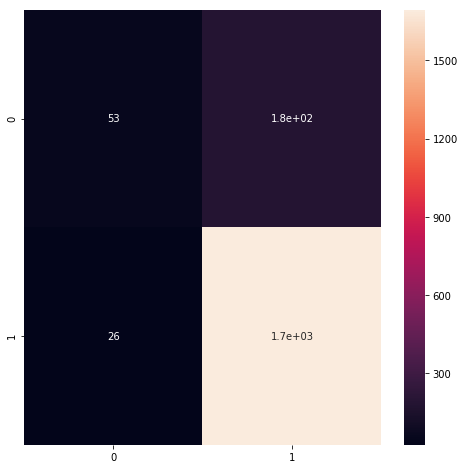

In [965]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize'] = (8, 8)
sns.heatmap(cm ,annot = True)

In [966]:
cvscores = cross_val_score(LogisticRegression(), X_train, y_train, cv=5, verbose=10, scoring='f1')
cvscores.mean()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/Users/floratalavera/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


[CV]  ................................................................
[CV] ....................... , score=0.9481481481481482, total=   0.5s
[CV]  ................................................................
[CV] ....................... , score=0.9464944649446494, total=   0.1s
[CV]  ................................................................
[CV] ....................... , score=0.9451360073766712, total=   0.1s
[CV]  ................................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.7s remaining:    0.0s


[CV] ....................... , score=0.9454209065679926, total=   0.2s
[CV]  ................................................................
[CV] ....................... , score=0.9485873089393239, total=   0.1s


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.9s finished


0.946757367195357

In [1009]:
clf = LogisticRegression()
clf.fit(X_train.toarray(), y_train)

/Users/floratalavera/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)

In [1010]:
y_pred = clf.predict(X_test.toarray())

In [999]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
print('Training set metrics:')
print('Accuracy:', accuracy_score(y_train, clf.predict(X_train.toarray())))
print('Precision:', precision_score(y_train, clf.predict(X_train.toarray())))
print('Recall:', recall_score(y_train, clf.predict(X_train.toarray())))
print('f1:', f1_score(y_train, clf.predict(X_train.toarray())))

print('Test set metrics:')
print('Accuracy:', accuracy_score(y_test, clf.predict(X_test.toarray())))
print('Precision:', precision_score(y_test, clf.predict(X_test.toarray())))
print('Recall:', recall_score(y_test, clf.predict(X_test.toarray())))
print('f1:', f1_score(y_test, clf.predict(X_test.toarray())))

Training set metrics:
Accuracy: 0.9212410501193318
Precision: 0.921998562185478
Recall: 0.9945715393563397
f1: 0.9569110240626748
Test set metrics:
Accuracy: 0.9069529652351738
Precision: 0.9107429182255479
Recall: 0.9912739965095986
f1: 0.9493036211699165


In [1018]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, clf.predict(X_test.toarray()))
cm

array([[  80,  173],
       [  12, 1691]])

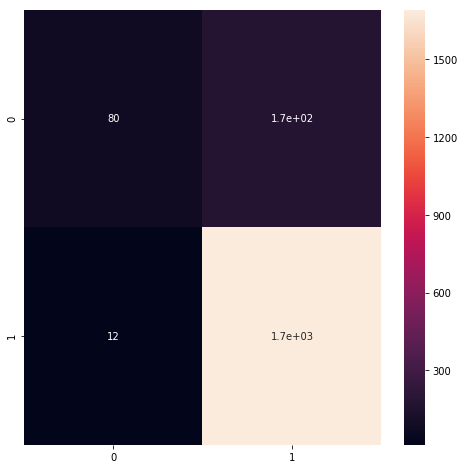

In [1019]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize'] = (8, 8)
sns.heatmap(cm ,annot = True)

In [972]:
#Import Gaussian Naive Bayes model
from sklearn.naive_bayes import GaussianNB

#Create a Gaussian Classifier
model = GaussianNB()

# Train the model using the training sets
model.fit(X_train.toarray(), y_train)

GaussianNB(priors=None, var_smoothing=1e-09)

In [973]:
y_pred = model.predict(X_test.toarray())

In [974]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
print('Training set metrics:')
print('Accuracy:', accuracy_score(y_train, model.predict(X_train.toarray())))
print('Precision:', precision_score(y_train, model.predict(X_train.toarray())))
print('Recall:', recall_score(y_train, model.predict(X_train.toarray())))
print('f1:', f1_score(y_train, model.predict(X_train.toarray())))

print('Test set metrics:')
print('Accuracy:', accuracy_score(y_test, model.predict(X_test.toarray())))
print('Precision:', precision_score(y_test, model.predict(X_test.toarray())))
print('Recall:', recall_score(y_test, model.predict(X_test.toarray())))
print('f1:', f1_score(y_test, model.predict(X_test.toarray())))

Training set metrics:
Accuracy: 0.6457551994544835
Precision: 1.0
Recall: 0.5971306708026367
f1: 0.7477543092983734
Test set metrics:
Accuracy: 0.5276073619631901
Precision: 0.8994974874371859
Recall: 0.52065154159395
f1: 0.6595431098010316


In [975]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_train, model.predict(X_train.toarray()))
cm

array([[ 708,    0],
       [2078, 3080]])

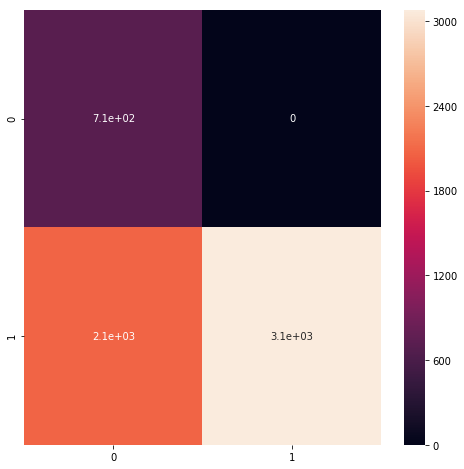

In [976]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize'] = (8, 8)
sns.heatmap(cm ,annot = True)

In [983]:
consumer_voice['Review_topic_modelling'][1]

'love gift receiv husband love smell rather good recommend'

In [1013]:
requested_str = 'blala'
clean_str = '''remove stopwords + lemm + etc'''
data = [clean_str]
vect = v.transform(data).toarray()
prediction = clf.predict(vect)

In [1014]:
prediction

array([1])

In [1017]:
vect = v.transform(['hate war toilet perfum stink']).toarray()
clf.predict(vect)

array([1])

In [ ]:
#STEP 9: TOPIC MODELLING